## Urban Mobility and Building Indicators: An analysis of Bike-Sharing Usage and Urban Structure in Ullern and Grünerløkka

### **Imports**
Here, all functions that are used later in the analysis are imported.
These are organized into separate modules for:
- data ingestion / data processing
- indicator computation
- visualization
- interactive map

In [1]:
import pathlib
from src.data_reading import data_to_gdf, csv_to_df
from src.data_processing import points_gdf, add_district, fetch_buildings
from src.indicators import mobilityindicators, buildingindicators
from src.visualization import plot_mobility_indicators, plot_timeprofile, plot_timeprofile_directions, plot_building_indicators, plot_buildingtypes
from src.map import interactive_map

### **Step 1: Data Ingestion / Data Processing**
Here, the three datasets used in the analysis are loaded:
- **district boundaries** (GeoJSON)
- **historical bicycle trips** (CSV)
- **buildings** retrieved from OpenStreetMap with `fetch_buildings`

All datasets are reprojected to a common coordinate referance system (`EPSG:25833`) to ensure that area, distance, and overlay operations are performed correctly.

In [2]:
NOTEBOOK_PATH = pathlib.Path().resolve()
DISTRICT_FILE = NOTEBOOK_PATH / "data" / "oslo_bydeler_befolkning_2024.geojson"
BIKE_HISTORY_FILE = NOTEBOOK_PATH / "data" / "sykkel_oktober_2025.csv"
TARGET_CRS = "EPSG:25833"

# Read data
districts = data_to_gdf(DISTRICT_FILE)
trips = csv_to_df(BIKE_HISTORY_FILE)
buildings = fetch_buildings(districts)

### Data Preview
Verification that files have been loaded correctly

In [3]:
districts.head(1)

,fid,bydelsnr,bynavn,bydel,befolkning_2024,geometry
0,1,030101,Oslo,Gamle Oslo,63721,"MULTIPOLYGON (((257239.61 6646410.66, 257463.2..."


In [4]:
trips.head(1)

,started_at,ended_at,duration,start_station_id,start_station_name,start_station_description,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_description,end_station_latitude,end_station_longitude
0,2025-10-01 03:02:11.567000+00:00,2025-10-01 03:13:40.482000+00:00,688,578,Hallings gate,langs Dalsbergstien,59.922777,10.738655,484,Karenslyst allé,ved Skabos vei,59.92033,10.683814


In `trips`, the position of the start and end stations are stored in separate columns. 
To make the structure of the code explicit, the names of these columns are defined explicitly.
The same applies to the columns containing district names. 

In [5]:
start_lat = "start_station_latitude"
start_lon = "start_station_longitude"
end_lat = "end_station_latitude"
end_lon = "end_station_longitude"
district_col = "bydel"

### Linking Bicycle Trips to Districts
To enable analysis of mobility at the district level, the start and end positions of the bicycle trips are first converted into GeoDataFrames. A spatial join is then applied to determine the district in which each trip both begins and ends. 

The result is a dataset containing information on:
- the district in which the trip starts
- the district in whcih the trip ends
- all trip attributes (time, station, distance, etc.)


In [6]:
# Make GeoDataFrame for start and end points
start_gdf = points_gdf(trips, start_lat, start_lon, target_crs=TARGET_CRS)
end_gdf = points_gdf(trips, end_lat, end_lon, target_crs=TARGET_CRS)

# Connect start and end points to districts
trips_in_districts = add_district(trips, start_gdf, end_gdf, districts, district_col)

## **Step 2: Indicator Computation**

### Mobility Indicators
`mobilityindicators()` computes, among other measures:
- the number of trips starting in a district
- the number of trips ending in the district
- net trips
- indicators per $\text{km}^2$
- indicators per capita

### Building Indicators
`buildingindicators()` computes, among other measures:
- the total number of buildings per district
- building density (number of buildings per $\text{km}^2$)
- total building area

The two sets of indicator data are merged into a single GeoDataFrame (`indicators`) which is used in subsequent analyses. 

In [7]:
# Compute mobility indicators and building indicators
mob_ind = mobilityindicators(districts, trips_in_districts)
build_ind = buildingindicators(buildings, districts)

The building indicators also include `area_km2` and `befolkning_2024`, which are already 
present in the mobility indicators. These duplicate columns are therefore removed prior to merging.

In [8]:
# Merging mob_ind og build_ind to a GeoDataFrame
build_ind = build_ind.drop(columns=[build_ind.geometry.name, "area_km2", "befolkning_2024"])
indicators = mob_ind.merge(build_ind, how="left", on="bydel")    

## **Step 3: Visualizations**

### Mobility Indicators 

The figure below presents a set of mobility indicators for Ullern and Grünerløkka. 

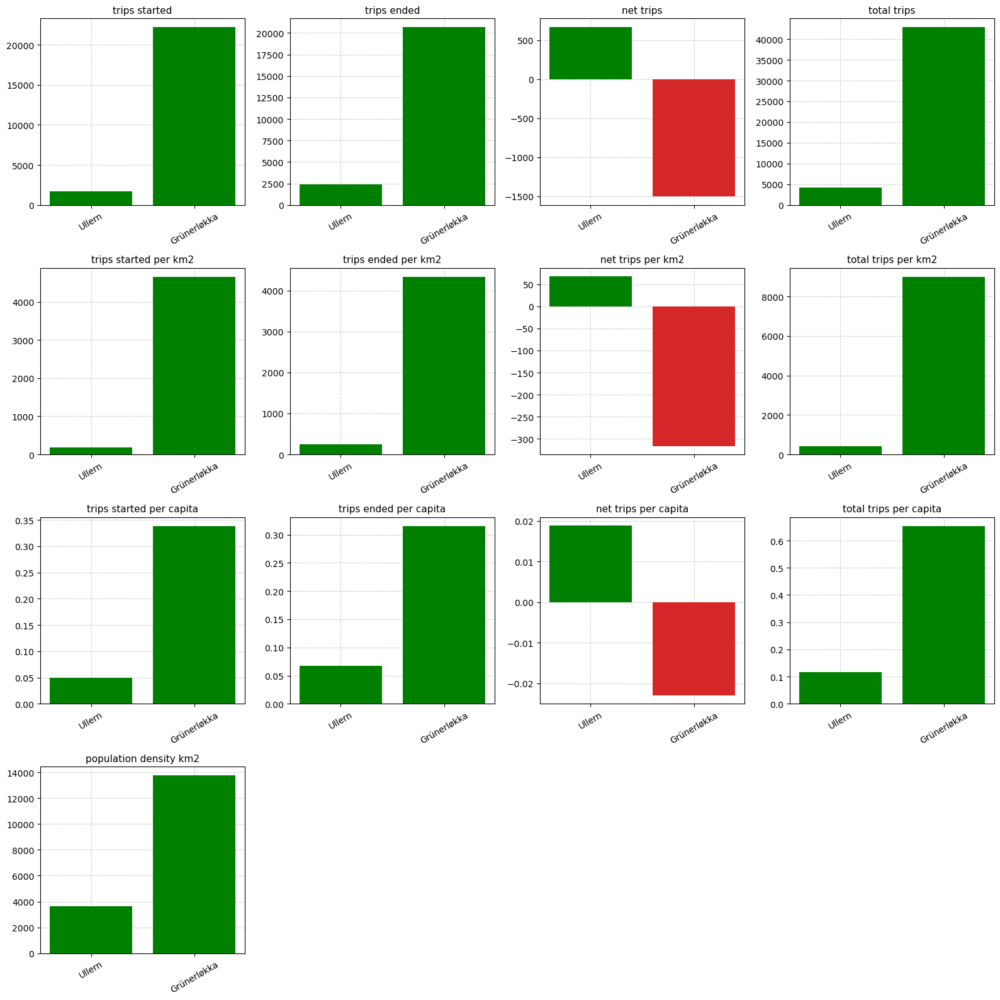

In [9]:
mob_ind_fig = plot_mobility_indicators(indicators, district_a="Ullern", district_b="Grünerløkka")

Grünerløkka exhibits a higher volume of both originating and terminating trips,
which is consistent with the districts higher poopulation density and more central location.

Over the period considered, Grünerløkka displays a negative net balance, meaning that more trips start
then end in the district, whereas Ullern show a slightly positive net balance, indicating that more trips
enter than leave the district. 
When trips are normalized by by district area, the difference is substantial: Grünerløkka has a manyfold higher trip density. 
This is attributable to the district's small geographic size, high population density, and concentration of destinations and activities. 
Even when normalized by population, cycling activity remains significantly higher in Grünerløkka, indicating that mobility levels are not driven by population alone, 
but also by urban form and the availability of activities. 

Although Grünerløkka has a higher population density than Ullern, it is the combination of high density and urban functions (such as restaurants, cultural venues, and retail)
that contributes to the elevated level of mobility.

Overall, the mobility indicators suggest that Grünerløkka functions as a major mobility hub within the city, 
whereas Ullern exhibits a substantially calmer mobility pattern. 

### Time Profile

The figure below illustrates how bicycle trips are distributed over the course of the day for the two districts.  

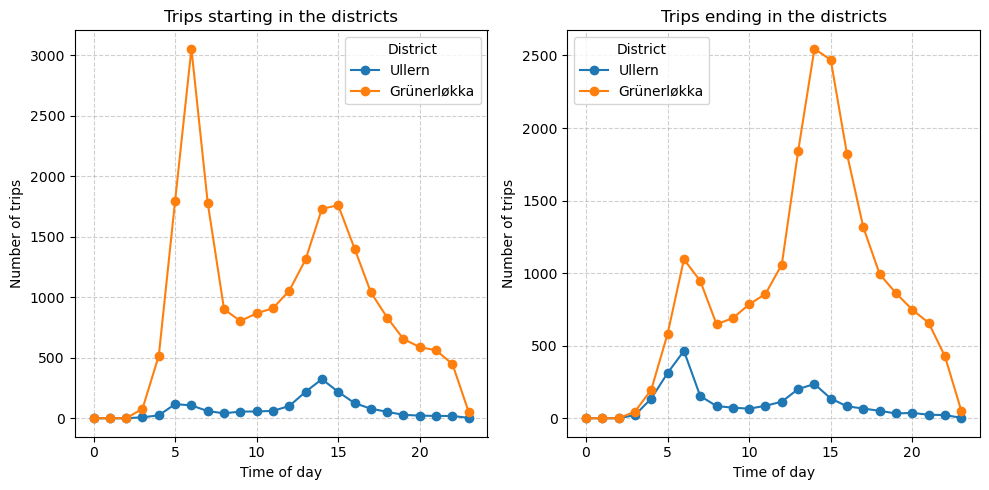

In [10]:
timeprofile = plot_timeprofile(trips_in_districts, district_a="Ullern", district_b="Grünerløkka")

Grünerløkka exhibits two pronounced peaks in bicycle activity: a morning peak around `08:00` and an afternoon peak around `15:00`, which is 
characteristic of central and highly active urban district. Ullern shows substantially lower volumes but follows a similar temporal rhythm.
Fewer trips originate in this district, yet a clear commuter patter is evident, which is consistent with the previously discussed mobility indicators. 

GRünerløkka displays a striong activty pattern throughout the day, reflecting on multiple trip purposes such as work, retail, and leisure, whereas Ullern primarly generates trips related to commuting to and from work. 

This diurnal pattern is typical of urban areas with differing population densitites and functional roles, such as residential districts versus central urban areas. 

### Time Profile for Inter-District Trips

The fihure shows bicycle trips from Ullern to Grünerløkka, and from Grünerløkka to Ullern.

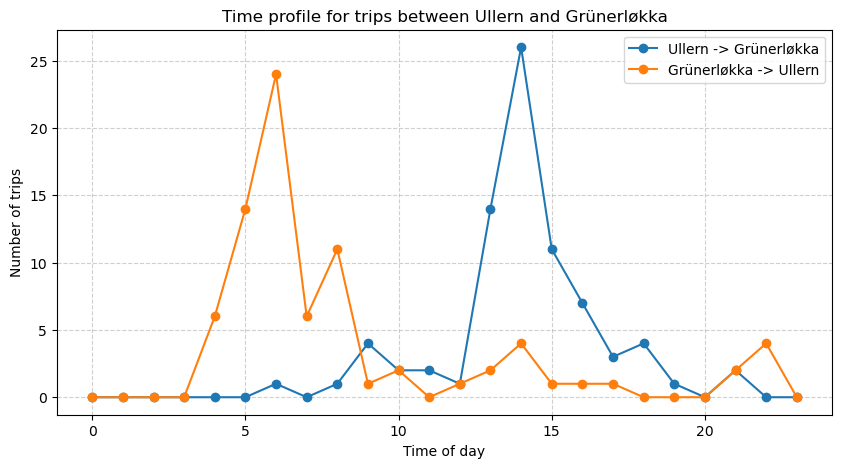

In [11]:
timeprofile_direction = plot_timeprofile_directions(trips_in_districts, district_a="Ullern", district_b="Grünerløkka")

The highest number of trips from Grünerløkka to Ullern occurs in the morning. This indicates that a substantial share of residents living in Grünerløkka
commute westward, which is consistent with the concentration of business activity in the Skøyen area. In the afternoon, the pattern is reversed, with more trips from Ullern to Grünerløkka, likely reflecting return journeys from work to home. 

Overall, this clearly demonstrates a commuter flow between the two districts.

### Building indicators

This figure presents a set of building-related indicators for Ullern and Grünerløkka:

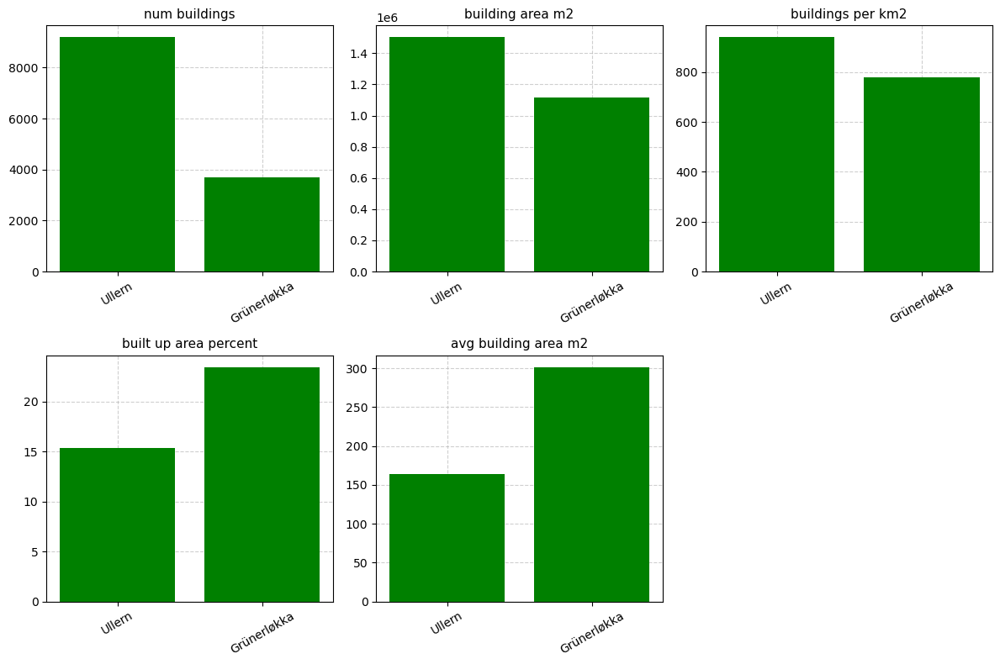

In [12]:
bygg_ind_fig = plot_building_indicators(indicators, district_a="Ullern", district_b="Grünerløkka")

Ullern has a higher total number of buildings; however, due to its large geographic extent, building density is low compared with Grünerløkka. 
Grünerløkka has a substantially higher proportion of built-up area. The average building size (in $\text{km}^2$) is also larger in Grünerløkka,
reflecting the prevalence of apartment blocks and larger residential complexes. 

These differences support the findings from the mobility indicators. High population density, a diverse supply of local amenitites, and housing typology
contribute to greater accessibillity and shorter travel distances, which in turn promote higher levels of cycling activity. 

### Building Types in Ullern and Grünerløkka

The figure illustrates the distribution of selected building types in the two districts. 

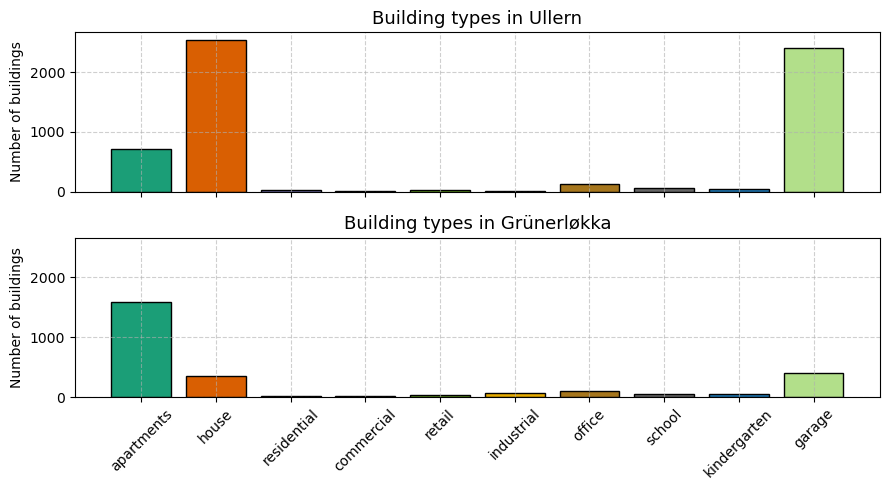

In [13]:
build_type = ["apartments", "house", "residential", "commercial", "retail", 
                "industrial", "office", "school", "kindergarten", "restaurant",
                "garage"]

building_types = plot_buildingtypes(buildings, district_a="Ullern", district_b="Grünerløkka", types=build_type)


Grünerløkka is dominated by apartment buildings, with smaller shares of office and retail-related structures. Ullern has a high proportion of detached houses and garages, indicating that the district is primarily characterized by low-density residential development.

In relation to mobility, districts with a high concentration of residential buildings and low population density, such as Ullern, generate relatively few bicycle trips. The large number of garages in Ullern also suggests a high level of car ownership, which likely contributes to greater reliance on private cars rather than bicycles. In contrast, districts with a high degree of functional mix and high population density, such as Grünerløkka, support frequent and diverse mobility patterns, including cycling.

Thus, the distribution of building types provides a structural explanation for the previously observed differences in mobility patterns.

## **Step 4: Interactive Map**

Finally, mobility data and building data are combined in an interactive map. 

The map displays:
- **Choropleth:** total number of trips per $\text{km}^2$ for each of the two selected districts.
- **Pop-up windows:** providing indicators such as:
    - area
    - population
    - population density
    - net trips per $\text{km}^2$ 
    - net trips per capita

- **Building layer:** individual buildings colored by building type. 

In [14]:
popup_cols = ["bydel", "area_km2", "population_density_km2", "befolkning_2024", "net_trips_per_km2", "net_trips_per_capita"]

map = interactive_map(
    indicators,
    buildings,
    choropleth_col="total_trips_per_km2",
    popup_cols=popup_cols,
    district_a="Ullern",
    district_b="Grünerløkka"
)

map


Grünerløkka appears highly dense and functionally diverse, whereas Ullern exhibits dispersed development and a limited range of building types, in line with the indicator results. Building density and the distribution of building types correspond closely with the intensity of cycling activity shown on the map.

The map therefore supports the earlier analyses and provides a holistic understanding of the relationship between mobility patterns and the urban environment.

Trips per $\text{km}^2$ are used as the choropleth variable because this normalizes for differences in district area and makes mobility levels more directly comparable across districts.